# Mining the Social Web

In [3]:
import networkx as nx

In [1]:
from github import Github

# XXX: Specify your own access token here

ACCESS_TOKEN = 'XXXXXXXXXXX'

# Specify a username and repository of interest for that user.

USER = 'ptwobrussell'
REPO = 'Mining-the-Social-Web-2nd-Edition'
#REPO = 'Mining-the-Social-Web-2nd-Edition'

client = Github(ACCESS_TOKEN, per_page=100)
user = client.get_user(USER)
repo = user.get_repo(REPO)

# Get a list of people who have bookmarked the repo.
# Since you'll get a lazy iterator back, you have to traverse
# it if you want to get the total number of stargazers.

stargazers = [ s for s in repo.get_stargazers() ]  #llamada a API toma unos segundos, dale tiempo!
print("Number of stargazers", len(stargazers))

Number of stargazers 2907


In [4]:
# Expand the initial graph with (interest) edges pointing each direction for 
# additional people interested. Take care to ensure that user and repo nodes 
# do not collide by appending their type.

g = nx.DiGraph()
g.add_node(repo.name + '(repo)', type='repo', lang=repo.language, owner=user.login)

for sg in stargazers:
    g.add_node(sg.login + '(user)', type='user')
    g.add_edge(sg.login + '(user)', repo.name + '(repo)', type='gazes')

In [5]:
repo.name

'Mining-the-Social-Web-2nd-Edition'

In [35]:
for sg in stargazers[:10]:
    print(sg.login)

aminert
tschloss
antiface
jwsy
j-e-d
carltongibson
rsmoz
stephenLee
dmr
assaflavi


In [28]:
print(g._node['Mining-the-Social-Web-2nd-Edition(repo)'])

{'type': 'repo', 'lang': 'HTML', 'owner': 'ptwobrussell'}


In [36]:
print(g._node['antiface(user)']) #si el nodo está en el grafo tiene la propiedad type

print(g['antiface(user)']['Mining-the-Social-Web-2nd-Edition(repo)']) #esta es una arista con su propiedad

{'type': 'user'}
{'type': 'gazes'}


In [8]:
list(g.nodes())[:10]

['Mining-the-Social-Web-2nd-Edition(repo)',
 'aminert(user)',
 'tschloss(user)',
 'antiface(user)',
 'jwsy(user)',
 'j-e-d(user)',
 'carltongibson(user)',
 'rsmoz(user)',
 'stephenLee(user)',
 'dmr(user)']

In [9]:
list(g.edges())[:10]

[('aminert(user)', 'Mining-the-Social-Web-2nd-Edition(repo)'),
 ('tschloss(user)', 'Mining-the-Social-Web-2nd-Edition(repo)'),
 ('antiface(user)', 'Mining-the-Social-Web-2nd-Edition(repo)'),
 ('jwsy(user)', 'Mining-the-Social-Web-2nd-Edition(repo)'),
 ('j-e-d(user)', 'Mining-the-Social-Web-2nd-Edition(repo)'),
 ('carltongibson(user)', 'Mining-the-Social-Web-2nd-Edition(repo)'),
 ('rsmoz(user)', 'Mining-the-Social-Web-2nd-Edition(repo)'),
 ('stephenLee(user)', 'Mining-the-Social-Web-2nd-Edition(repo)'),
 ('dmr(user)', 'Mining-the-Social-Web-2nd-Edition(repo)'),
 ('assaflavi(user)', 'Mining-the-Social-Web-2nd-Edition(repo)')]

## Adding additional interest edges to the graph through the inclusion of "follows" edges

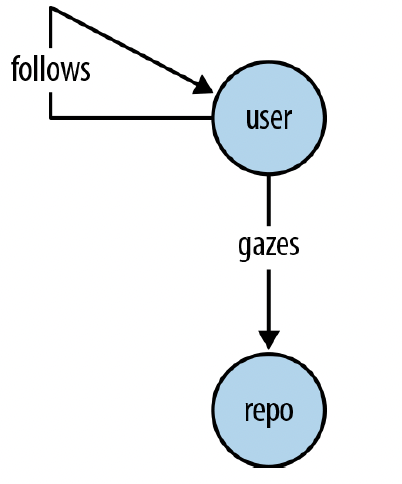

In [14]:
aux = 0
for i, sg in enumerate(stargazers):
    print(i, sg)
    aux += 1
    if aux >9:
        break

0 NamedUser(login="aminert")
1 NamedUser(login="tschloss")
2 NamedUser(login="antiface")
3 NamedUser(login="jwsy")
4 NamedUser(login="j-e-d")
5 NamedUser(login="carltongibson")
6 NamedUser(login="rsmoz")
7 NamedUser(login="stephenLee")
8 NamedUser(login="dmr")
9 NamedUser(login="assaflavi")


In [42]:
# Add (social) edges from the stargazers' followers. This can take a while 
# because of all of the potential API calls to GitHub. The approximate number
# of requests for followers for each iteration of this loop can be calculated as
# math.ceil(sg.get_followers() / 100.0) per the API returning up to 100 items
# at a time.

import sys

for i, sg in enumerate(stargazers):
    
    # Add "follows" edges between stargazers in the graph if any relationships exist
    try:
        for follower in sg.get_followers():
            if follower.login + '(user)' in g:
                g.add_edge(follower.login + '(user)', sg.login + '(user)', 
                           type='follows')
    except Exception as e: #ssl.SSLError
        print("Encountered an error fetching followers for", sg.login, \
              "Skipping.", file=sys.stderr)
        print(e, file=sys.stderr)

    print("Processed", i+1, " stargazers. Num nodes/edges in graph", \
          g.number_of_nodes(), "/", g.number_of_edges())
    print("Rate limit remaining", client.rate_limiting)

Processed 1  stargazers. Num nodes/edges in graph 2908 / 2908
Rate limit remaining (4999, 5000)
Processed 2  stargazers. Num nodes/edges in graph 2908 / 2908
Rate limit remaining (4998, 5000)
Processed 3  stargazers. Num nodes/edges in graph 2908 / 2914
Rate limit remaining (4996, 5000)
Processed 4  stargazers. Num nodes/edges in graph 2908 / 2915
Rate limit remaining (4995, 5000)
Processed 5  stargazers. Num nodes/edges in graph 2908 / 2916
Rate limit remaining (4994, 5000)
Processed 6  stargazers. Num nodes/edges in graph 2908 / 2927
Rate limit remaining (4979, 5000)
Processed 7  stargazers. Num nodes/edges in graph 2908 / 2928
Rate limit remaining (4978, 5000)
Processed 8  stargazers. Num nodes/edges in graph 2908 / 2929
Rate limit remaining (4977, 5000)
Processed 9  stargazers. Num nodes/edges in graph 2908 / 2934
Rate limit remaining (4976, 5000)
Processed 10  stargazers. Num nodes/edges in graph 2908 / 2934
Rate limit remaining (4975, 5000)
Processed 11  stargazers. Num nodes/edg

In [17]:
#nx.write_graphml(g, "/Users/lorenarecalde/Documents/JupyterProjects/USFQ_BigData/lab4/grafoGitHub.graphml")

In [28]:
G = nx.read_graphml("/Users/lorenarecalde/Documents/JupyterProjects/USFQ_BigData/lab4/grafoGitHub.graphml")

In [29]:
print(G)

DiGraph with 2908 nodes and 5868 edges


In [30]:
list(G.edges())[3000:3010]

[('angusshire(user)', 'outformatics(user)'),
 ('angusshire(user)', 'allanozzolo(user)'),
 ('angusshire(user)', 'blackout314(user)'),
 ('angusshire(user)', 'Mistobaan(user)'),
 ('angusshire(user)', 'mzagaja(user)'),
 ('angusshire(user)', 'mvaude(user)'),
 ('angusshire(user)', 'sunhill(user)'),
 ('angusshire(user)', 'drivelous(user)'),
 ('angusshire(user)', 'jknipp(user)'),
 ('angusshire(user)', 'skyvory(user)')]

In [31]:
G['angusshire(user)']['outformatics(user)']

{'type': 'follows'}

In [32]:
print(G['antiface(user)']['Mining-the-Social-Web-2nd-Edition(repo)'])

{'type': 'gazes'}


In [33]:
G._node['angusshire(user)']

{'type': 'user'}

## Exploring the updated graph's "follows" edges

In [34]:
from operator import itemgetter
from collections import Counter

In [36]:
# The number of "follows" edges is the difference
print(len([e for e in G.edges(data=True) if e[2]['type'] == 'follows']))

2961


In [37]:
# The number of "gazes" edges is the difference
print(len([e for e in G.edges(data=True) if e[2]['type'] == 'gazes']))

2907


In [40]:
targets = [i[1] for i in list(G.in_edges())]    

In [41]:
from collections import Counter
freq = Counter(targets)

In [42]:
freq.most_common(20)

[('Mining-the-Social-Web-2nd-Edition(repo)', 2907),
 ('CamDavidsonPilon(user)', 135),
 ('angusshire(user)', 83),
 ('zygmuntz(user)', 80),
 ('josephmisiti(user)', 59),
 ('rossant(user)', 43),
 ('chdoig(user)', 33),
 ('clarecorthell(user)', 30),
 ('jadianes(user)', 25),
 ('dwillis(user)', 20),
 ('vlandham(user)', 18),
 ('trietptm(user)', 17),
 ('avinassh(user)', 16),
 ('ajschumacher(user)', 16),
 ('Yorko(user)', 16),
 ('umaar(user)', 15),
 ('buunguyen(user)', 15),
 ('krmaxwell(user)', 14),
 ('johnymontana(user)', 14),
 ('mattharrison(user)', 14)]

In [43]:
G.in_degree()

InDegreeView({'Mining-the-Social-Web-2nd-Edition(repo)': 2907, 'aminert(user)': 1, 'tschloss(user)': 0, 'antiface(user)': 6, 'jwsy(user)': 1, 'j-e-d(user)': 1, 'carltongibson(user)': 11, 'rsmoz(user)': 1, 'stephenLee(user)': 1, 'dmr(user)': 5, 'assaflavi(user)': 0, 'herrfz(user)': 0, 'flashus(user)': 1, 'javiertejero(user)': 1, 'kevinbluer(user)': 5, 'gjuhasz(user)': 0, 'zeristor(user)': 1, 'wangqi(user)': 1, 'aburan28(user)': 3, 'karmiphuc(user)': 1, 'enriquesanchezb(user)': 0, 'mherradora(user)': 0, 'chishaku(user)': 0, 'yaph(user)': 10, 'onlydole(user)': 2, 'lauts(user)': 0, 'w7tek(user)': 1, 'bagini(user)': 0, 'rdempsey(user)': 5, 'prb(user)': 2, 'hbmartin(user)': 1, 'menorki(user)': 1, 'mtayseer(user)': 1, 'cmollet(user)': 0, 'PepSalehi(user)': 2, 'ricardogarfe(user)': 0, 'Stecki(user)': 0, 'JT5D(user)': 7, 'marsam(user)': 3, 'ds604(user)': 0, 'HaveF(user)': 3, 'rossant(user)': 43, 'asw456(user)': 1, 'mikepsn(user)': 2, 'benwong(user)': 0, 'druzn3k(user)': 2, 'kdwcse(user)': 0, 't

In [45]:
print(len(G.in_edges(['CamDavidsonPilon(user)'])))

135


In [49]:
# Let's examine the number of adjacent edges to each node
print(sorted([n for n in G.degree()], key=itemgetter(1), reverse=True)[:10])

[('Mining-the-Social-Web-2nd-Edition(repo)', 2907), ('angusshire(user)', 995), ('frankfanslc(user)', 188), ('CamDavidsonPilon(user)', 136), ('rohithadassanayake(user)', 86), ('zygmuntz(user)', 81), ('trietptm(user)', 79), ('josephmisiti(user)', 62), ('rossant(user)', 55), ('mcanthony(user)', 40)]


In [50]:
# Consider the ratio of incoming and outgoing edges for a couple of users with 
# high node degrees...

print(len(G.out_edges('angusshire(user)')))
print(len(G.in_edges('angusshire(user)')))

912
83


In [54]:
c = Counter([e[1] for e in G.edges(data=True) if e[2]['type'] == 'follows'])
popular_users = [ (u, f) for (u, f) in c.most_common() if f > 1 ]
print("Number of popular users", len(popular_users))
print("Top 10 popular users:", popular_users[:10])

Number of popular users 454
Top 10 popular users: [('CamDavidsonPilon(user)', 135), ('angusshire(user)', 83), ('zygmuntz(user)', 80), ('josephmisiti(user)', 59), ('rossant(user)', 43), ('chdoig(user)', 33), ('clarecorthell(user)', 30), ('jadianes(user)', 25), ('dwillis(user)', 20), ('vlandham(user)', 18)]


## Applying centrality measures to the interest graph

In [57]:
from operator import itemgette

h = G.copy()

# Remove the seed of the interest graph, which is a supernode, in order
# to get a better idea of the network dynamics

h.remove_node('Mining-the-Social-Web-2nd-Edition(repo)')

# XXX: Remove any other nodes that appear to be supernodes.
# Filter any other nodes that you can by threshold
# criteria or heuristics from inspection.

# Display the centrality measures for the top 10 nodes


dc = sorted(nx.degree_centrality(h).items(), 
            key=itemgetter(1), reverse=True)

print("Degree Centrality")
print(dc[:10])
print()

bc = sorted(nx.betweenness_centrality(h).items(), 
            key=itemgetter(1), reverse=True)

print("Betweenness Centrality")
print(bc[:10])
print()

print("Closeness Centrality")
cc = sorted(nx.closeness_centrality(h).items(), 
            key=itemgetter(1), reverse=True)
print(cc[:10])

Degree Centrality
[('angusshire(user)', 0.34205092911218166), ('frankfanslc(user)', 0.06434962147281487), ('CamDavidsonPilon(user)', 0.04645560908465244), ('rohithadassanayake(user)', 0.029249827942188573), ('zygmuntz(user)', 0.027529249827942186), ('trietptm(user)', 0.026841018582243633), ('josephmisiti(user)', 0.02099105299380592), ('rossant(user)', 0.018582243633860976), ('mcanthony(user)', 0.013420509291121816), ('JT5D(user)', 0.012732278045423262)]

Betweenness Centrality
[('angusshire(user)', 0.043944217259939314), ('lisongx(user)', 0.020350691083634187), ('randombrein(user)', 0.020164792058920106), ('bcho(user)', 0.016041104722464374), ('emptymalei(user)', 0.015134052650338016), ('demon386(user)', 0.014926134264049293), ('pakozm(user)', 0.01420278789639959), ('esafak(user)', 0.01401123977226129), ('znmeb(user)', 0.013657285452085083), ('ajschumacher(user)', 0.011647685375480811)]

Closeness Centrality
[('CamDavidsonPilon(user)', 0.063309649691622), ('zygmuntz(user)', 0.053635639

## Graph visualization of the social network for the original interest graph

In [59]:
print("Stats on the full graph")
print(G)
print()

# Create a subgraph from a collection of nodes. In this case, the
# collection is all of the users in the original interest graph

mtsw_users = [n for n in G if G._node[n]['type'] == 'user']
h = G.subgraph(mtsw_users)

print("Stats on the extracted subgraph")
print(h)

Stats on the full graph
DiGraph with 2908 nodes and 5868 edges

Stats on the extracted subgraph
DiGraph with 2907 nodes and 2961 edges


In [69]:
import matplotlib.pyplot as plt
fig = plt.figure(1, figsize=(200, 80), dpi=60)
nx.draw(h, with_labels=True, font_weight='normal')

## Using Matplotlib and NetworkX to create graph visualizations

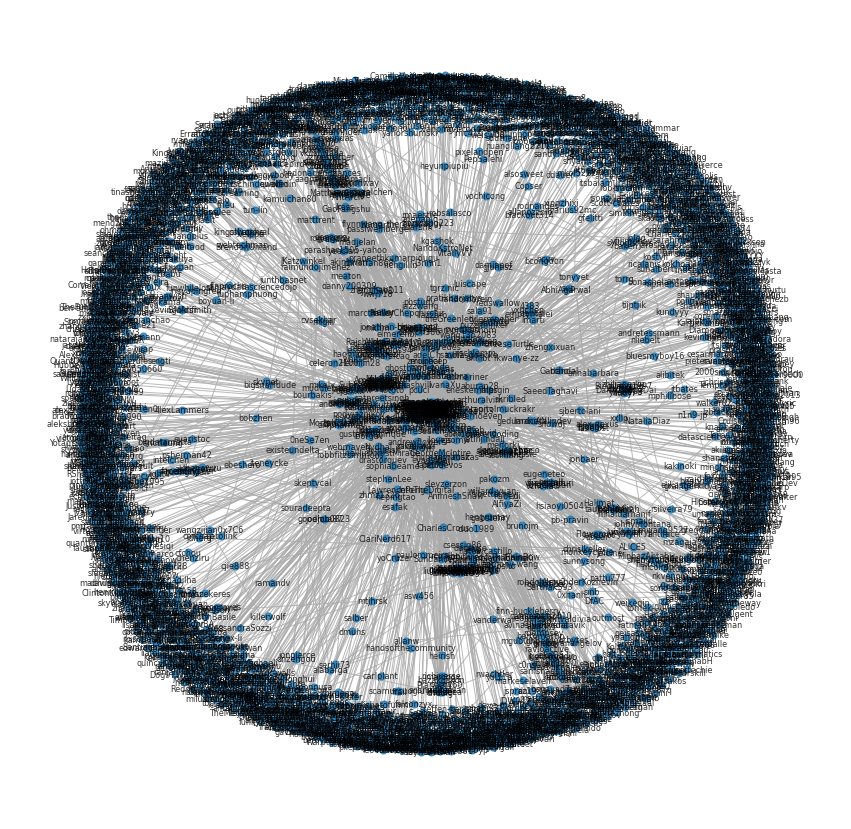

In [71]:
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")
%matplotlib inline


fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111)
labels = dict([(n, n.split('(user)')[0]) for n in h.nodes()])

nx.draw(h, pos=nx.spring_layout(h), 
        arrows=False, ax=ax, node_size=50,
        edge_color='#aaaaaa',
        alpha=0.8, labels=labels, font_size=8)

In [ ]:
from networkx.readwrite import json_graph

# guardar el grafo en un archivo json
d = json_graph.node_link_data(h)
json.dump(d, open('force.json', 'w'))